In [21]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
%matplotlib inline

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, make_scorer
import xgboost as xgb
import lightgbm as lgb
from sklearn.feature_selection import RFECV

In [2]:
train_df = pd.read_csv('./preprocessed_data/train_set.csv')

In [3]:
train_df.columns

Index(['game_id', 'club_id_x', 'club_id_y', 'B365HW', 'B365D', 'B365AW',
       'Table_x', 'Table_y', 'manager_name_x', 'manager_name_y',
       'home_team_id', 'Result', 'Referee', 'total_games_x', 'wins_x',
       'win_percentage_x', 'total_games_vs_opponent_x', 'wins_vs_opponent_x',
       'win_percentage_vs_opponent_x', 'TY_x', 'OY_x', 'TR_x', 'OR_x',
       'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 'Shot on Target_x',
       'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x',
       'Save%_x', 'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x',
       'Exp. Assisted Goals_x', 'Expected Assists_x', 'Tackles Won_x',
       '% of Dribblers Tackled_x', 'Blocks_x', 'Interceptions_x', 'Error_x',
       'market_value_in_eur_x', 'total_games_y', 'wins_y', 'win_percentage_y',
       'total_games_vs_opponent_y', 'wins_vs_opponent_y',
       'win_percentage_vs_opponent_y', 'TY_y', 'OY_y', 'TR_y', 'OR_y',
       'Possesion_y', 'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot o

In [4]:
# 모델링에 사용되지 않는 game_id 제외, 종속변수인 result 컬럼 제외

independent_variable = ['club_id_x', 'club_id_y', 'B365HW', 'B365D', 'B365AW',
       'Table_x', 'Table_y', 'manager_name_x', 'manager_name_y',
       'home_team_id', 'Referee', 'total_games_x', 'wins_x',
       'win_percentage_x', 'total_games_vs_opponent_x', 'wins_vs_opponent_x',
       'win_percentage_vs_opponent_x', 'TY_x', 'OY_x', 'TR_x', 'OR_x',
       'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 'Shot on Target_x',
       'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x',
       'Save%_x', 'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x',
       'Exp. Assisted Goals_x', 'Expected Assists_x', 'Tackles Won_x',
       '% of Dribblers Tackled_x', 'Blocks_x', 'Interceptions_x', 'Error_x',
       'market_value_in_eur_x', 'total_games_y', 'wins_y', 'win_percentage_y',
       'total_games_vs_opponent_y', 'wins_vs_opponent_y',
       'win_percentage_vs_opponent_y', 'TY_y', 'OY_y', 'TR_y', 'OR_y',
       'Possesion_y', 'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot on Target_y',
       'Shot on Target(%)_y', 'Goals per Shot_y', 'Expected Goals_y',
       'Save%_y', 'Clean Sheet_y', 'Pass Completion %_y', 'Assists_y',
       'Exp. Assisted Goals_y', 'Expected Assists_y', 'Tackles Won_y',
       '% of Dribblers Tackled_y', 'Blocks_y', 'Interceptions_y', 'Error_y',
       'market_value_in_eur_y']

In [5]:
# 전처리 

In [6]:
# 1. null 체크

In [7]:
# 앞에서 데이터를 합치는 과정에서 null값은 다 처리
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2176 entries, 0 to 2175
Data columns (total 73 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   game_id                       2176 non-null   int64  
 1   club_id_x                     2176 non-null   int64  
 2   club_id_y                     2176 non-null   int64  
 3   B365HW                        2176 non-null   float64
 4   B365D                         2176 non-null   float64
 5   B365AW                        2176 non-null   float64
 6   Table_x                       2176 non-null   int64  
 7   Table_y                       2176 non-null   int64  
 8   manager_name_x                2176 non-null   int64  
 9   manager_name_y                2176 non-null   int64  
 10  home_team_id                  2176 non-null   int64  
 11  Result                        2176 non-null   int64  
 12  Referee                       2176 non-null   int64  
 13  tot

In [8]:
# 2. 이상치 체크

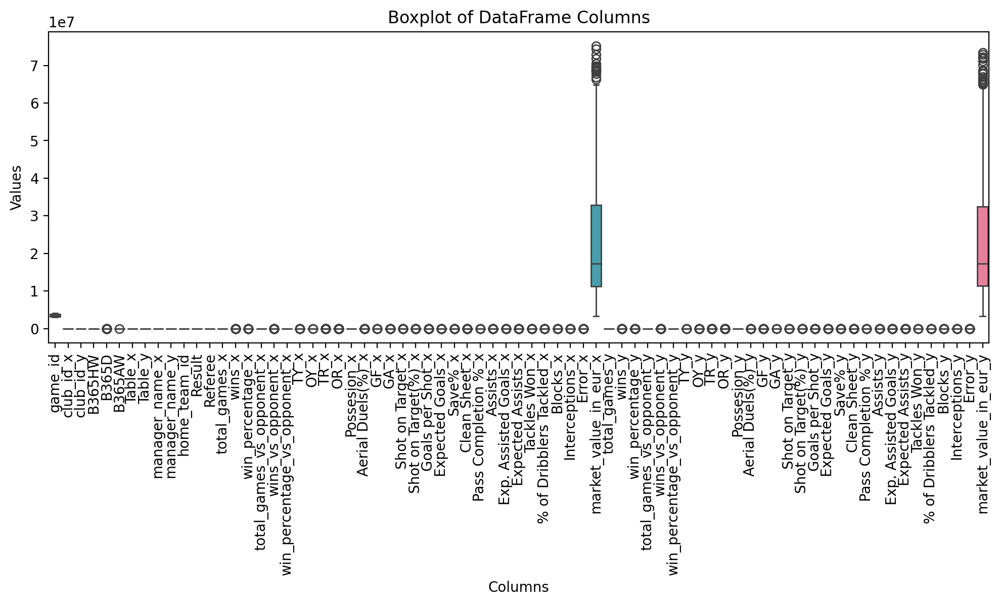

In [11]:
plt.figure(figsize=(12, 4))
sns.boxplot(data=train_df)
plt.title('Boxplot of DataFrame Columns')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.xticks(rotation=90)
plt.show()

In [12]:
# market value컬럼의 범위가 너무커서 한 프레임에 안 들어오므로 제외하고 boxplot

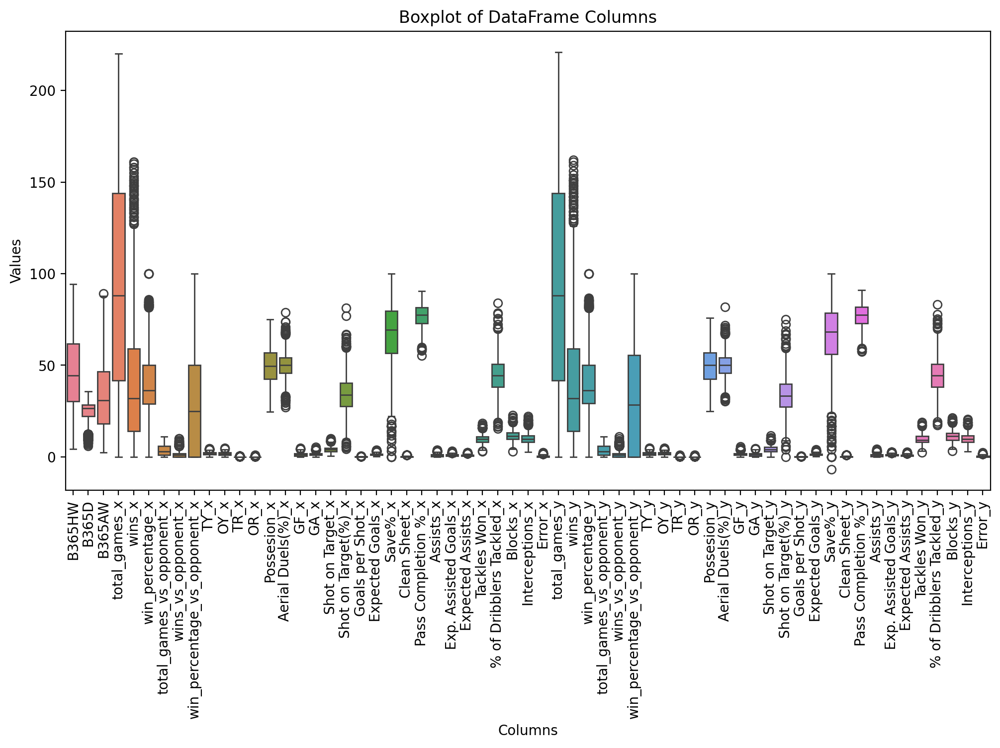

In [13]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=train_df[['B365HW', 'B365D', 'B365AW', 'total_games_x', 'wins_x',
                           'win_percentage_x', 'total_games_vs_opponent_x', 'wins_vs_opponent_x',
                           'win_percentage_vs_opponent_x', 'TY_x', 'OY_x', 'TR_x', 'OR_x',
                           'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 'Shot on Target_x',
                           'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x', 'Save%_x', 
                           'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x', 'Exp. Assisted Goals_x', 
                           'Expected Assists_x', 'Tackles Won_x', '% of Dribblers Tackled_x', 'Blocks_x', 
                           'Interceptions_x', 'Error_x', 'total_games_y', 'wins_y', 
                           'win_percentage_y', 'total_games_vs_opponent_y', 'wins_vs_opponent_y',
                           'win_percentage_vs_opponent_y', 'TY_y', 'OY_y', 'TR_y', 'OR_y', 'Possesion_y', 
                           'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot on Target_y', 'Shot on Target(%)_y', 
                           'Goals per Shot_y', 'Expected Goals_y', 'Save%_y', 'Clean Sheet_y', 'Pass Completion %_y', 
                           'Assists_y', 'Exp. Assisted Goals_y', 'Expected Assists_y', 'Tackles Won_y',
                           '% of Dribblers Tackled_y', 'Blocks_y', 'Interceptions_y', 'Error_y']])
plt.title('Boxplot of DataFrame Columns')
plt.xlabel('Columns')
plt.ylabel('Values')
plt.xticks(rotation=90)
plt.show()

In [14]:
# IQR 기반으로 데이터를 삭제하면 너무 많은 컬럼들이 삭제되므로 Z-Score를 기준으로 확인하여 삭제하기로 결정

In [15]:
# 히스토그램으로 데이터 확인

In [9]:
def get_4_hist(data:pd.DataFrame, columns:list):
    
    plt.figure(figsize=(15, 4 * (len(columns) // 4)))

    for i, col in enumerate(columns):
        plt.subplot(len(columns) // 4 + (len(columns) % 4 > 0), 4, i + 1)
        sns.histplot(data[col], kde=True)
        plt.title(col)

    # 전체 그림 표시
    plt.tight_layout()
    plt.show()

In [10]:
distribution_check_col = ['B365HW', 'B365D', 'B365AW', 'total_games_x', 'wins_x', 'win_percentage_x', 
                          'total_games_vs_opponent_x', 'wins_vs_opponent_x', 'win_percentage_vs_opponent_x', 
                          'TY_x', 'OY_x', 'TR_x', 'OR_x', 'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 
                          'Shot on Target_x', 'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x', 
                          'Save%_x', 'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x', 'Exp. Assisted Goals_x', 
                          'Expected Assists_x', 'Tackles Won_x', '% of Dribblers Tackled_x', 'Blocks_x', 
                          'Interceptions_x', 'Error_x', 'market_value_in_eur_x', 'total_games_y', 'wins_y', 'win_percentage_y',
                          'total_games_vs_opponent_y', 'wins_vs_opponent_y', 'win_percentage_vs_opponent_y', 
                          'TY_y', 'OY_y', 'TR_y', 'OR_y', 'Possesion_y', 'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot on Target_y', 
                          'Shot on Target(%)_y', 'Goals per Shot_y', 'Expected Goals_y', 'Save%_y', 'Clean Sheet_y', 
                          'Pass Completion %_y', 'Assists_y', 'Exp. Assisted Goals_y', 'Expected Assists_y', 'Tackles Won_y', 
                          '% of Dribblers Tackled_y', 'Blocks_y', 'Interceptions_y', 'Error_y', 'market_value_in_eur_y']

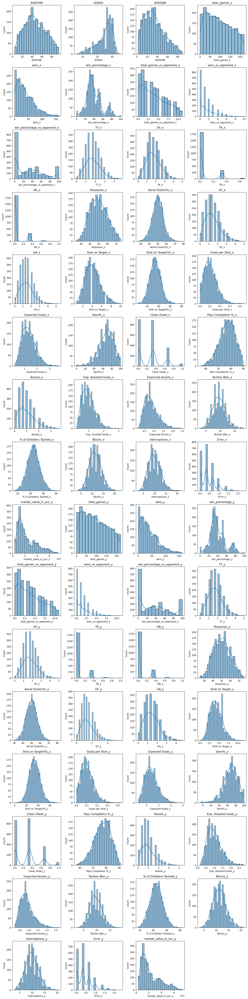

In [19]:
# 컬럼 분포 히스토그램으로 확인
get_4_hist(train_df, distribution_check_col)

In [18]:
# 3. 이상치 제거하기

In [11]:
# z-score를 계산하여 이상치가 있는지 확인하고 이상치를 제외한 데이터 반환
def remove_outliers(df, threshold):
    z_scores = (df - df.mean()) / df.std()
    no_outliers_df = df[(z_scores <= threshold) & (z_scores >= -threshold)]
    return no_outliers_df

In [12]:
def plot_histogram_with_outliers(df, threshold):
    num_columns = len(df.columns)
    fig, axs = plt.subplots(num_columns, 2, figsize=(8, 3*num_columns))  # 크기 조정
    
    # 이상치 제거한 횟수를 저장할 리스트
    outlier_removal_counts = []
    
    for i, col in enumerate(df.columns):
        # 이상치 제거 전 히스토그램
        sns.histplot(df[col], bins=30, color='blue', alpha=0.7, kde=True, ax=axs[i, 0])  
        axs[i, 0].set_title(f'{col} (Before)')
        axs[i, 0].set_xlabel('Values')
        axs[i, 0].set_ylabel('Frequency')
        
        # 이상치 제거 후 히스토그램
        no_outliers_df = remove_outliers(df[col], threshold)
        sns.histplot(no_outliers_df, bins=30, color='green', alpha=0.7, kde=True, ax=axs[i, 1])
        axs[i, 1].set_title(f'{col} (After)')
        axs[i, 1].set_xlabel('Values')
        axs[i, 1].set_ylabel('Frequency')
        
        # 이상치 제거한 횟수 저장
        outlier_removal_counts.append(len(df) - len(no_outliers_df))

    # 이상치 제거한 횟수를 출력
    for i, col in enumerate(df.columns):
        print(f'Number of outliers removed in {col}: {outlier_removal_counts[i]}')

    plt.tight_layout()
    plt.show()

In [23]:
# 데이터프레임에서 이상치 제거 전/후 히스토그램 그리기 : threshold 3
plot_histogram_with_outliers(train_df[distribution_check_col], 3)

Number of outliers removed in B365HW: 0
Number of outliers removed in B365D: 9
Number of outliers removed in B365AW: 0
Number of outliers removed in total_games_x: 0
Number of outliers removed in wins_x: 29
Number of outliers removed in win_percentage_x: 5
Number of outliers removed in total_games_vs_opponent_x: 0
Number of outliers removed in wins_vs_opponent_x: 30
Number of outliers removed in win_percentage_vs_opponent_x: 0
Number of outliers removed in TY_x: 9
Number of outliers removed in OY_x: 3
Number of outliers removed in TR_x: 32
Number of outliers removed in OR_x: 32
Number of outliers removed in Possesion_x: 0
Number of outliers removed in Aerial Duels(%)_x: 9
Number of outliers removed in GF_x: 19
Number of outliers removed in GA_x: 15
Number of outliers removed in Shot on Target_x: 9
Number of outliers removed in Shot on Target(%)_x: 11
Number of outliers removed in Goals per Shot_x: 16
Number of outliers removed in Expected Goals_x: 18
Number of outliers removed in Save%

In [24]:
# 데이터프레임에서 이상치 제거 전/후 히스토그램 그리기 : threshold 4
plot_histogram_with_outliers(train_df[distribution_check_col], 4)

Number of outliers removed in B365HW: 0
Number of outliers removed in B365D: 0
Number of outliers removed in B365AW: 0
Number of outliers removed in total_games_x: 0
Number of outliers removed in wins_x: 0
Number of outliers removed in win_percentage_x: 0
Number of outliers removed in total_games_vs_opponent_x: 0
Number of outliers removed in wins_vs_opponent_x: 7
Number of outliers removed in win_percentage_vs_opponent_x: 0
Number of outliers removed in TY_x: 0
Number of outliers removed in OY_x: 1
Number of outliers removed in TR_x: 32
Number of outliers removed in OR_x: 32
Number of outliers removed in Possesion_x: 0
Number of outliers removed in Aerial Duels(%)_x: 1
Number of outliers removed in GF_x: 1
Number of outliers removed in GA_x: 3
Number of outliers removed in Shot on Target_x: 0
Number of outliers removed in Shot on Target(%)_x: 2
Number of outliers removed in Goals per Shot_x: 7
Number of outliers removed in Expected Goals_x: 2
Number of outliers removed in Save%_x: 0
N

In [25]:
# # 데이터프레임에서 이상치 제거 전/후 히스토그램 그리기 : threshold 5
plot_histogram_with_outliers(train_df[distribution_check_col], 5)

Number of outliers removed in B365HW: 0
Number of outliers removed in B365D: 0
Number of outliers removed in B365AW: 0
Number of outliers removed in total_games_x: 0
Number of outliers removed in wins_x: 0
Number of outliers removed in win_percentage_x: 0
Number of outliers removed in total_games_vs_opponent_x: 0
Number of outliers removed in wins_vs_opponent_x: 3
Number of outliers removed in win_percentage_vs_opponent_x: 0
Number of outliers removed in TY_x: 0
Number of outliers removed in OY_x: 0
Number of outliers removed in TR_x: 0
Number of outliers removed in OR_x: 1
Number of outliers removed in Possesion_x: 0
Number of outliers removed in Aerial Duels(%)_x: 0
Number of outliers removed in GF_x: 0
Number of outliers removed in GA_x: 0
Number of outliers removed in Shot on Target_x: 0
Number of outliers removed in Shot on Target(%)_x: 0
Number of outliers removed in Goals per Shot_x: 1
Number of outliers removed in Expected Goals_x: 0
Number of outliers removed in Save%_x: 0
Num

In [13]:
# z-score 3, 4 의 경우 많은 수의 데이터를 삭제해야 해서 z-score 5를 기준으로 하여 이상치 제거
train_df[distribution_check_col] = train_df[distribution_check_col].apply(lambda x: remove_outliers(x, 5))

In [14]:
train_df = train_df.dropna()

In [15]:
# 15개 행 삭제됨
train_df

,game_id,club_id_x,club_id_y,B365HW,B365D,B365AW,Table_x,Table_y,manager_name_x,manager_name_y,...,Pass Completion %_y,Assists_y,Exp. Assisted Goals_y,Expected Assists_y,Tackles Won_y,% of Dribblers Tackled_y,Blocks_y,Interceptions_y,Error_y,market_value_in_eur_y
0,3050217,11,29,69.444444,20.000000,13.333333,6,12,82,40,...,77.633333,1.333333,0.766667,0.866667,12.333333,50.566667,9.666667,10.000000,0.666667,1.792857e+07
1,3050227,11,1010,69.444444,19.607843,14.285714,5,6,82,32,...,65.400000,1.333333,0.766667,0.733333,12.000000,52.166667,13.000000,16.000000,0.333333,7.142857e+06
2,3050247,11,1003,65.359477,22.222222,15.384615,4,11,82,13,...,78.266667,1.333333,1.000000,0.900000,12.333333,47.633333,13.333333,9.333333,0.333333,1.522344e+07
3,3050267,11,31,25.641026,25.641026,51.282051,5,3,82,36,...,82.333333,1.000000,0.800000,0.800000,8.666667,49.700000,10.666667,8.000000,0.666667,4.684615e+07
4,3050277,11,543,60.240964,23.809524,19.047619,5,11,82,53,...,78.300000,0.000000,0.900000,0.733333,9.666667,39.900000,10.333333,13.000000,0.000000,1.277381e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2171,4095279,1237,543,60.606061,23.094688,20.000000,7,11,67,25,...,72.400000,2.000000,1.200000,0.900000,13.000000,52.166667,12.666667,10.000000,0.666667,1.643611e+07
2172,4095299,1237,873,58.823529,25.000000,21.052632,8,14,67,68,...,77.433333,1.666667,0.733333,0.833333,10.666667,56.933333,11.333333,7.666667,0.000000,1.926758e+07
2173,4095333,1237,29,54.644809,26.315789,23.809524,7,15,67,73,...,73.733333,0.666667,1.200000,0.766667,15.000000,59.133333,13.333333,13.666667,0.000000,1.680149e+07
2174,4095353,1237,703,55.555556,25.000000,25.000000,8,17,67,53,...,75.666667,1.333333,1.866667,0.900000,10.333333,57.000000,14.666667,8.000000,0.333333,1.668189e+07


In [24]:
# 표준화

In [25]:
# 4. log 스케일링

In [26]:
# log 스케일링을 했을 때 어떻게 변화할지 그래프로 보기

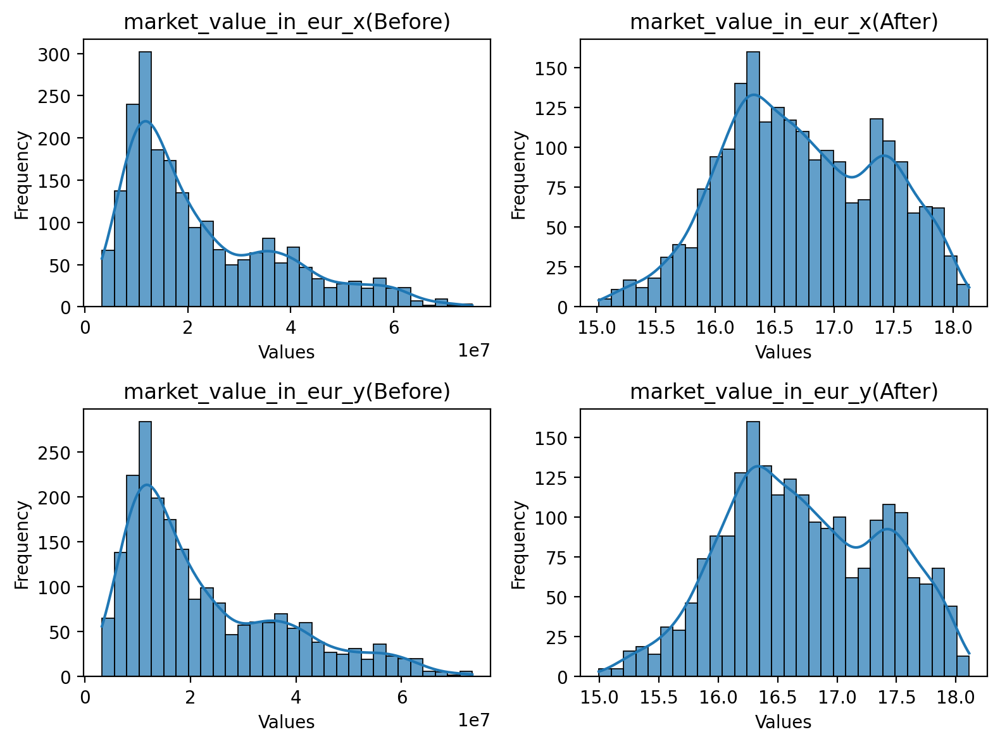

In [27]:
# 그래프 그리기
fig, axs = plt.subplots(2, 2, figsize=(8, 6)) 
    
# 이상치 제거 전 히스토그램
sns.histplot(train_df['market_value_in_eur_x'], bins=30, alpha=0.7, kde=True, ax=axs[0, 0])  
axs[0, 0].set_title('market_value_in_eur_x(Before)')
axs[0, 0].set_xlabel('Values')
axs[0, 0].set_ylabel('Frequency')

# 이상치 제거 후 히스토그램
sns.histplot(np.log1p(train_df['market_value_in_eur_x']), bins=30, alpha=0.7, kde=True, ax=axs[0, 1])  
axs[0, 1].set_title('market_value_in_eur_x(After)')
axs[0, 1].set_xlabel('Values')
axs[0, 1].set_ylabel('Frequency')

# 이상치 제거 전 히스토그램
sns.histplot(train_df['market_value_in_eur_y'], bins=30, alpha=0.7, kde=True, ax=axs[1, 0])  
axs[1, 0].set_title('market_value_in_eur_y(Before)')
axs[1, 0].set_xlabel('Values')
axs[1, 0].set_ylabel('Frequency')

# 이상치 제거 후 히스토그램
sns.histplot(np.log1p(train_df['market_value_in_eur_y']), bins=30, alpha=0.7, kde=True, ax=axs[1, 1])  
axs[1, 1].set_title('market_value_in_eur_y(After)')
axs[1, 1].set_xlabel('Values')
axs[1, 1].set_ylabel('Frequency')  

plt.tight_layout()
plt.show()

In [16]:
# 값의 단위가 크고 약갼 좌측편향 되었던 'market_value_in_eur_x', 'market_value_in_eur_y' 2개의 컬럼만 log 스케일링 하기

skewed_col = ['market_value_in_eur_x', 'market_value_in_eur_y']

In [17]:
train_df[skewed_col] = np.log1p(train_df[skewed_col])

In [18]:
train_df.columns

Index(['game_id', 'club_id_x', 'club_id_y', 'B365HW', 'B365D', 'B365AW',
       'Table_x', 'Table_y', 'manager_name_x', 'manager_name_y',
       'home_team_id', 'Result', 'Referee', 'total_games_x', 'wins_x',
       'win_percentage_x', 'total_games_vs_opponent_x', 'wins_vs_opponent_x',
       'win_percentage_vs_opponent_x', 'TY_x', 'OY_x', 'TR_x', 'OR_x',
       'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 'Shot on Target_x',
       'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x',
       'Save%_x', 'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x',
       'Exp. Assisted Goals_x', 'Expected Assists_x', 'Tackles Won_x',
       '% of Dribblers Tackled_x', 'Blocks_x', 'Interceptions_x', 'Error_x',
       'market_value_in_eur_x', 'total_games_y', 'wins_y', 'win_percentage_y',
       'total_games_vs_opponent_y', 'wins_vs_opponent_y',
       'win_percentage_vs_opponent_y', 'TY_y', 'OY_y', 'TR_y', 'OR_y',
       'Possesion_y', 'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot o

In [19]:
# scaling할 컬럼

col_to_minmax = ['B365HW', 'B365D', 'B365AW',
       'total_games_x', 'wins_x',
       'win_percentage_x', 'total_games_vs_opponent_x', 'wins_vs_opponent_x',
       'win_percentage_vs_opponent_x', 'TY_x', 'OY_x', 'TR_x', 'OR_x',
       'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 'Shot on Target_x',
       'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x',
       'Save%_x', 'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x',
       'Exp. Assisted Goals_x', 'Expected Assists_x', 'Tackles Won_x',
       '% of Dribblers Tackled_x', 'Blocks_x', 'Interceptions_x', 'Error_x',
       'total_games_y', 'wins_y', 'win_percentage_y',
       'total_games_vs_opponent_y', 'wins_vs_opponent_y',
       'win_percentage_vs_opponent_y', 'TY_y', 'OY_y', 'TR_y', 'OR_y',
       'Possesion_y', 'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot on Target_y',
       'Shot on Target(%)_y', 'Goals per Shot_y', 'Expected Goals_y',
       'Save%_y', 'Clean Sheet_y', 'Pass Completion %_y', 'Assists_y',
       'Exp. Assisted Goals_y', 'Expected Assists_y', 'Tackles Won_y',
       '% of Dribblers Tackled_y', 'Blocks_y', 'Interceptions_y', 'Error_y']

In [32]:
# 5. robust scaling

In [22]:
# RobustScaler 객체 생성
scaler = RobustScaler()

In [23]:
# 선택한 컬럼에 대해 스케일링 적용
train_df[col_to_minmax] = scaler.fit_transform(train_df[col_to_minmax])

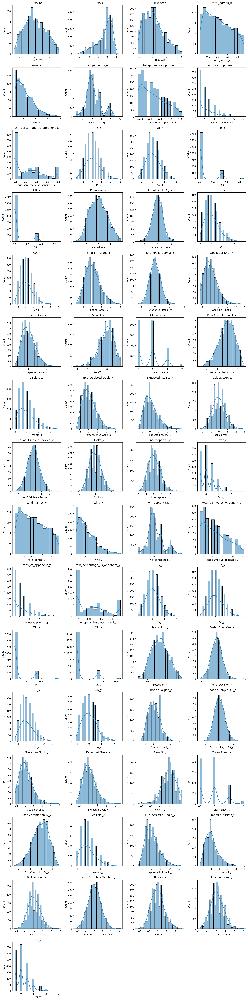

In [24]:
get_4_hist(train_df, col_to_minmax)

In [25]:
independent_variable = ['club_id_x', 'club_id_y', 'B365HW', 'B365D', 'B365AW',
       'Table_x', 'Table_y', 'manager_name_x', 'manager_name_y',
       'home_team_id', 'Referee', 'total_games_x', 'wins_x',
       'win_percentage_x', 'total_games_vs_opponent_x', 'wins_vs_opponent_x',
       'win_percentage_vs_opponent_x', 'TY_x', 'OY_x', 'TR_x', 'OR_x',
       'Possesion_x', 'Aerial Duels(%)_x', 'GF_x', 'GA_x', 'Shot on Target_x',
       'Shot on Target(%)_x', 'Goals per Shot_x', 'Expected Goals_x',
       'Save%_x', 'Clean Sheet_x', 'Pass Completion %_x', 'Assists_x',
       'Exp. Assisted Goals_x', 'Expected Assists_x', 'Tackles Won_x',
       '% of Dribblers Tackled_x', 'Blocks_x', 'Interceptions_x', 'Error_x',
       'market_value_in_eur_x', 'total_games_y', 'wins_y', 'win_percentage_y',
       'total_games_vs_opponent_y', 'wins_vs_opponent_y',
       'win_percentage_vs_opponent_y', 'TY_y', 'OY_y', 'TR_y', 'OR_y',
       'Possesion_y', 'Aerial Duels(%)_y', 'GF_y', 'GA_y', 'Shot on Target_y',
       'Shot on Target(%)_y', 'Goals per Shot_y', 'Expected Goals_y',
       'Save%_y', 'Clean Sheet_y', 'Pass Completion %_y', 'Assists_y',
       'Exp. Assisted Goals_y', 'Expected Assists_y', 'Tackles Won_y',
       '% of Dribblers Tackled_y', 'Blocks_y', 'Interceptions_y', 'Error_y',
       'market_value_in_eur_y']

In [26]:
# 데이터셋 train과 test로 나누기
X = train_df[independent_variable]
y = train_df['Result']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [27]:
# RandomForest

In [28]:
rf_model = RandomForestClassifier(n_estimators=100, max_depth=None, random_state=42)
rf_model.fit(X_train, y_train)

y_pred = rf_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5727482678983834
F1 Score: 0.5155778009100124


In [29]:
rf_model = RandomForestClassifier(n_estimators=200, max_depth=None, random_state=42)
rf_model.fit(X_train, y_train)

y_pred = rf_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5842956120092379
F1 Score: 0.522846065173938


In [37]:
rf_model = RandomForestClassifier(n_estimators=200, max_depth=6, random_state=42)
rf_model.fit(X_train, y_train)

y_pred = rf_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5935334872979214
F1 Score: 0.5177819621852123


In [48]:
# xgboost

In [41]:
xgb_model = xgb.XGBClassifier(n_estimators=100, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5542725173210161
F1 Score: 0.5323378635630043


In [42]:
xgb_model = xgb.XGBClassifier(n_estimators=200, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5519630484988453
F1 Score: 0.5328400473821686


In [43]:
xgb_model = xgb.XGBClassifier(n_estimators=300, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5565819861431871
F1 Score: 0.5386176107438799


In [45]:
xgb_model = xgb.XGBClassifier(n_estimators=300, max_depth=1, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5612009237875288
F1 Score: 0.5350494079198235


In [47]:
xgb_model = xgb.XGBClassifier(n_estimators=300, max_depth=1, learning_rate=0.1, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5750577367205543
F1 Score: 0.5226144145286983


In [48]:
xgb_model = xgb.XGBClassifier(n_estimators=300, max_depth=1, learning_rate=0.05, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5866050808314087
F1 Score: 0.5206367004326353


In [49]:
xgb_model = xgb.XGBClassifier(n_estimators=100, max_depth=1, learning_rate=0.05, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.6004618937644342
F1 Score: 0.5239396499588304


In [51]:
xgb_model = xgb.XGBClassifier(n_estimators=100, max_depth=1, learning_rate=0.07, random_state=42)
xgb_model.fit(X_train, y_train)

y_pred = xgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.6004618937644342
F1 Score: 0.5240063206515133


In [57]:
# GradientBoosting

In [53]:
gb_model = GradientBoostingClassifier(n_estimators=100, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5750577367205543
F1 Score: 0.5475256311497991


In [54]:
gb_model = GradientBoostingClassifier(n_estimators=60, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5773672055427251
F1 Score: 0.5428295802580368


In [55]:
gb_model = GradientBoostingClassifier(n_estimators=70, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5889145496535797
F1 Score: 0.5567116178167535


In [56]:
gb_model = GradientBoostingClassifier(n_estimators=80, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5796766743648961
F1 Score: 0.5475293112745038


In [57]:
gb_model = GradientBoostingClassifier(n_estimators=70, max_depth=1, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5912240184757506
F1 Score: 0.519303535660816


In [58]:
gb_model = GradientBoostingClassifier(n_estimators=70, max_depth=2, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5912240184757506
F1 Score: 0.5440289378374099


In [59]:
gb_model = GradientBoostingClassifier(n_estimators=70, max_depth=2, learning_rate=0.07, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5912240184757506
F1 Score: 0.5402463233693124


In [60]:
gb_model = GradientBoostingClassifier(n_estimators=70, max_depth=2, learning_rate=0.08, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5958429561200924
F1 Score: 0.5410312087989878


In [61]:
gb_model = GradientBoostingClassifier(n_estimators=70, max_depth=2, learning_rate=0.09, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5958429561200924
F1 Score: 0.5489212142655105


In [62]:
gb_model = GradientBoostingClassifier(n_estimators=80, max_depth=2, learning_rate=0.08, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5958429561200924
F1 Score: 0.54672933155868


In [63]:
gb_model = GradientBoostingClassifier(n_estimators=80, max_depth=2, learning_rate=0.1, random_state=42)
gb_model.fit(X_train, y_train)

# 테스트 데이터로 예측
y_pred = gb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

Accuracy: 0.5935334872979214
F1 Score: 0.5486445740735444


In [64]:
# lightGBM

In [65]:
lgb_model = lgb.LGBMClassifier(n_estimators=100, random_state=42)
lgb_model.fit(X_train, y_train)

y_pred = lgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000970 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7088
[LightGBM] [Info] Number of data points in the train set: 1728, number of used features: 71
[LightGBM] [Info] Start training from score -1.498883
[LightGBM] [Info] Start training from score -0.808329
[LightGBM] [Info] Start training from score -1.105581
Accuracy: 0.5565819861431871
F1 Score: 0.5351632864334415


In [66]:
lgb_model = lgb.LGBMClassifier(n_estimators=50, random_state=42)
lgb_model.fit(X_train, y_train)

y_pred = lgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001397 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7088
[LightGBM] [Info] Number of data points in the train set: 1728, number of used features: 71
[LightGBM] [Info] Start training from score -1.498883
[LightGBM] [Info] Start training from score -0.808329
[LightGBM] [Info] Start training from score -1.105581
Accuracy: 0.5681293302540416
F1 Score: 0.5396159935846334


In [67]:
lgb_model = lgb.LGBMClassifier(n_estimators=50, max_depth=1, random_state=42)
lgb_model.fit(X_train, y_train)

y_pred = lgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001021 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 7088
[LightGBM] [Info] Number of data points in the train set: 1728, number of used features: 71
[LightGBM] [Info] Start training from score -1.498883
[LightGBM] [Info] Start training from score -0.808329
[LightGBM] [Info] Start training from score -1.105581
Accuracy: 0.6004618937644342
F1 Score: 0.5239693328955329


In [68]:
lgb_model = lgb.LGBMClassifier(n_estimators=50, max_depth=1, learning_rate=0.07, random_state=42)
lgb_model.fit(X_train, y_train)

y_pred = lgb_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred, average='weighted')
print("Accuracy:", accuracy)
print("F1 Score:", f1)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000780 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7088
[LightGBM] [Info] Number of data points in the train set: 1728, number of used features: 71
[LightGBM] [Info] Start training from score -1.498883
[LightGBM] [Info] Start training from score -0.808329
[LightGBM] [Info] Start training from score -1.105581
Accuracy: 0.605080831408776
F1 Score: 0.5272469376118868
